# scVelo for integrated junctional epithelium (D0, D3 and D5) scRNA-seq (dynamical model)

This is a note for trial work dealing with the velocity from intact and post-injure junctional epithelial cells (Krt14+ and the "near" populations). All mapped data are from cell ranger 4. All csv files were generated by R-based analysis ("Integrate_JE_harmony_downstream.Rmd") from a integrated Seurat Object ("JE_combined_epi_harmony_MAGIC_renamed.rds") and three independent loom files which was initially the outputs from velocyto.

Platform: ubuntu 20.0 in xiyou cloud

Author: Huan Liu Affiliation: School and hospital of stomatology, Wuhan University Data: 2022-12-24


## 1 Module Load 

In [1]:
import anndata
import scvelo as scv
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
%load_ext rpy2.ipython

## 2 Data import and manipulation

In [2]:
# Import count matrix
s = scv.read("./scVeloInput/JE_combined_epi_spliced.csv")
u = scv.read("./scVeloInput/JE_combined_epi_unspliced.csv")
sample_one  = s
sample_one.layers['spliced'] = s.X
sample_one.layers['unspliced'] = u.X

In [3]:
sample_one

AnnData object with n_obs × n_vars = 21491 × 28000
    layers: 'spliced', 'unspliced'

In [4]:
sample_one.obs.index

Index(['D0_AAACGCTCACGCAGTC-1', 'D0_AAACGAACAATATCCG-1',
       'D0_AAACGCTCATCACCAA-1', 'D0_AAAGAACGTGCCGTTG-1',
       'D0_AAAGAACCATGCACTA-1', 'D0_AAACGCTCATAGCACT-1',
       'D0_AAAGAACTCTCCCAAC-1', 'D0_AAACGCTGTGTCCTAA-1',
       'D0_AAAGGATGTGTAACGG-1', 'D0_AAAGAACGTTCGGTCG-1',
       ...
       'D5_TTTGGAGGTCGTGGTC-1', 'D5_TTTGGTTTCAAAGACA-1',
       'D5_TTGTTCACAGGACTAG-1', 'D5_TTTATGCGTGTCTTCC-1',
       'D5_TTTCGATTCAAACTGC-1', 'D5_TTTATGCCAAGAATAC-1',
       'D5_TTTACCAAGAGTCTTC-1', 'D5_TTTACCAAGAGTCAGC-1',
       'D5_TTTCACACAACCAATC-1', 'D5_TTTACCACAATACAGA-1'],
      dtype='object', length=21491)

In [5]:
# Import cell attributes
sample_obs = pd.read_csv("./scVeloInput/JE_combined_epi_MAGIC_cellID_obs.csv")
umap_cord = pd.read_csv("./scVeloInput/JE_combined_epi_MAGIC_cell_embeddings.csv")
cell_clusters = pd.read_csv("./scVeloInput/JE_combined_epi_MAGIC_clusters.csv")
cell_clusters.head() # double check the barcodes for cells AND column name for barcode is "Unamed".

,Unnamed,celltype
0,D0_AAACCCAAGCGGTAGT-1,GE4
1,D0_AAACCCACAAATAGCA-1,GE6
2,D0_AAACCCACACGAGGTA-1,GE3
3,D0_AAACCCACAGGTCCCA-1,GE7
4,D0_AAACCCAGTCTTACAG-1,GE1


In [6]:
umap_cord.head() # double check the barcodes for cells AND column name for barcode is "Unamed:0".

,Unnamed: 0,UMAP_1,UMAP_2
0,D0_AAACCCAAGCGGTAGT-1,4.406812,1.466055
1,D0_AAACCCACAAATAGCA-1,1.389605,-4.155154
2,D0_AAACCCACACGAGGTA-1,-5.084413,0.777817
3,D0_AAACCCACAGGTCCCA-1,-1.328065,6.881142
4,D0_AAACCCAGTCTTACAG-1,-1.391496,-4.351899


In [7]:
sample_obs.head() # double check the barcodes for cells AND column name for barcode is "Cells(JE_combined_epi_MAGIC)".

,Cells(JE_combined_epi_MAGIC)
0,D0_AAACCCAAGCGGTAGT-1
1,D0_AAACCCACAAATAGCA-1
2,D0_AAACCCACACGAGGTA-1
3,D0_AAACCCACAGGTCCCA-1
4,D0_AAACCCAGTCTTACAG-1


In [8]:
#Intersect Cells info from Seurat (filtered) with loom files (unfiltered)

sample_one = sample_one[np.isin(sample_one.obs.index,sample_obs["Cells(JE_combined_epi_MAGIC)"])]
sample_one.obs.head()
sample_one # check data structure # n_obs × n_vars = 6883 × 28000 indicating the successful intersection


View of AnnData object with n_obs × n_vars = 6883 × 28000
    layers: 'spliced', 'unspliced'

In [9]:
#Add Umap cordinations to umap info from Seurat

umap_cord = umap_cord.rename(columns = {'Unnamed: 0':'CellID'})
umap_cord
umap_cord.rename (columns= {'Cell ID': 'CellID'}, inplace=True)
umap_cord

,CellID,UMAP_1,UMAP_2
0,D0_AAACCCAAGCGGTAGT-1,4.406812,1.466055
1,D0_AAACCCACAAATAGCA-1,1.389605,-4.155154
2,D0_AAACCCACACGAGGTA-1,-5.084413,0.777817
3,D0_AAACCCACAGGTCCCA-1,-1.328065,6.881142
4,D0_AAACCCAGTCTTACAG-1,-1.391496,-4.351899
...,...,...,...
6878,D5_TTTCGATTCAAACTGC-1,-4.203887,1.867818
6879,D5_TTTGATCAGGTAGGCT-1,-2.608255,-1.871719
6880,D5_TTTGGAGTCAACGCTA-1,2.649866,-0.870563
6881,D5_TTTGGTTTCAAAGACA-1,-4.282679,4.588359


In [10]:
sample_one_index = pd.DataFrame(sample_one.obs.index)
sample_one_index = sample_one_index.rename(columns = {0:'CellID'})
umap_ordered = sample_one_index.merge(umap_cord,on="CellID")
umap_ordered.head()

,CellID,UMAP_1,UMAP_2
0,D0_AAAGGATGTGTAACGG-1,-0.736346,1.103499
1,D0_AAAGAACGTTCGGTCG-1,1.655639,-0.316509
2,D0_AAAGAACCAACAGCCC-1,-2.557216,-4.744899
3,D0_AAAGGGCAGAGTTGCG-1,-6.497510,-0.027424
4,D0_AAACGCTGTCGAGTGA-1,2.761179,-0.727062


In [11]:
#Addcluster info to cell info in the metadata from Seurat

cell_clusters = cell_clusters.rename(columns = {"Unnamed":'CellID'})
#order
cell_clusters = sample_one_index.merge(cell_clusters,on="CellID")
cell_clusters.head()

,CellID,celltype
0,D0_AAAGGATGTGTAACGG-1,GE5
1,D0_AAAGAACGTTCGGTCG-1,GE8
2,D0_AAAGAACCAACAGCCC-1,GE1
3,D0_AAAGGGCAGAGTTGCG-1,GE3
4,D0_AAACGCTGTCGAGTGA-1,GE2


In [12]:
# Add Cell cluster info to AnnData

cell_clusters_ordered=cell_clusters.iloc[:,1]
sample_one.obs['cell_clusters']=cell_clusters_ordered.values

In [13]:
#Add umap info to cell info to AnnData
umap_ordered = umap_ordered.iloc[:,1:]
sample_one.obsm['X_umap'] = umap_ordered.values
sample_one

AnnData object with n_obs × n_vars = 6883 × 28000
    obs: 'cell_clusters'
    obsm: 'X_umap'
    layers: 'spliced', 'unspliced'

In [14]:
# We extracted color code from Seurat-based umap using Adobe Illustrator
ident_colors = ["#F8766D", #JE1
                "#D39200", #JE2
                "#93AA00", #JE3
                "#00BA38", #JE4
                "#00C19F", #JE5
                "#00B9E3", #JE6
                "#619CFF", #JE7
                "#DB72FB", #JE8
                "#FF61C3" #JE9
               ]

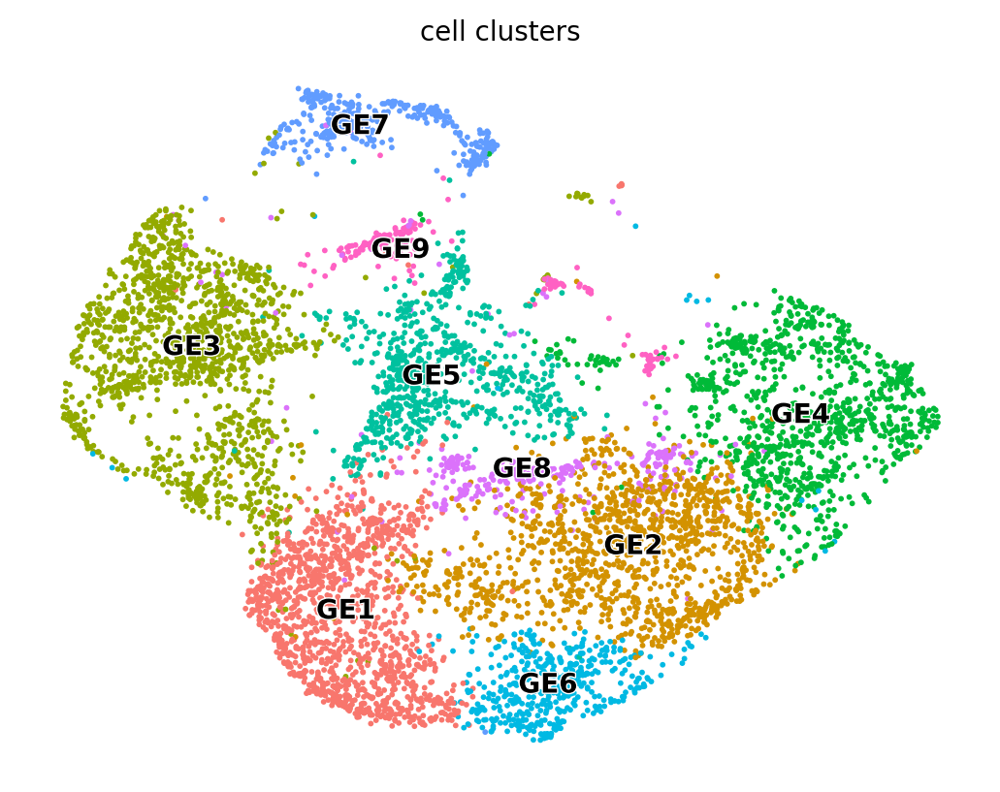

In [15]:
scv.pl.umap(sample_one, color="cell_clusters", 
            palette=ident_colors,
           legend_loc='on data')
# make sure the colors and layout is the same as we saw in Seurat

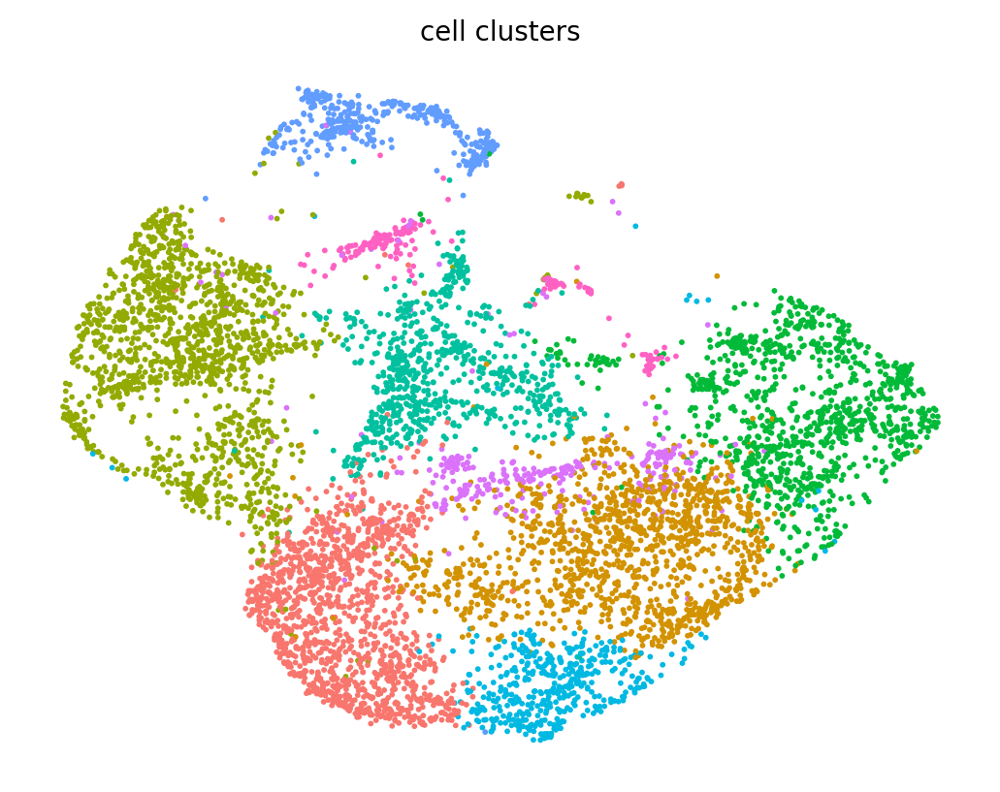

In [16]:
scv.pl.umap(sample_one, color="cell_clusters", 
            palette=ident_colors,
           legend_loc='none')
# make sure the colors and layout is the same as we saw in Seurat

## 3 RNA velocity by scVelo dynamical model

## 3.1 Dynamical model imputation

In [17]:
#Running RNA Velocity
scv.pp.filter_genes(sample_one)


In [18]:
scv.tl.recover_dynamics(sample_one, n_jobs=8)

recovering dynamics (using 8/24 cores)
or disable the progress bar using `show_progress_bar=False`.


not recoverable due to insufficient samples.


not recoverable due to insufficient samples.


not recoverable due to insufficient samples.


Brinp3 not recoverable due to insufficient samples.


not recoverable due to insufficient samples.


not recoverable due to insufficient samples.
not recoverable due to insufficient samples.


Tnfsf8 not recoverable due to insufficient samples.


not recoverable due to insufficient samples.


not recoverable due to insufficient samples.


not recoverable due to insufficient samples.


 Vwf


not recoverable due to insufficient samples.


not recoverable due to insufficient samples.


not recoverable due to insufficient samples.


    finished (0:31:43) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [19]:
scv.tl.velocity(sample_one, mode='dynamical', n_jobs = 8)

Normalized count data: X, spliced, unspliced.
computing neighbors
    finished (0:00:12) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
not recoverable due to insufficient samples.
    finished (0:00:23) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
C130080G10Rik not recoverable due to insufficient samples.


Gm12333 not recoverable due to insufficient samples.


not recoverable due to insufficient samples.
    finished (0:02:33) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [20]:
scv.tl.velocity_graph(sample_one, n_jobs = 8)

computing velocity graph (using 8/24 cores)
    finished (0:00:38) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:04) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_JE_combined_epi_dynamic_velo_gray.svg


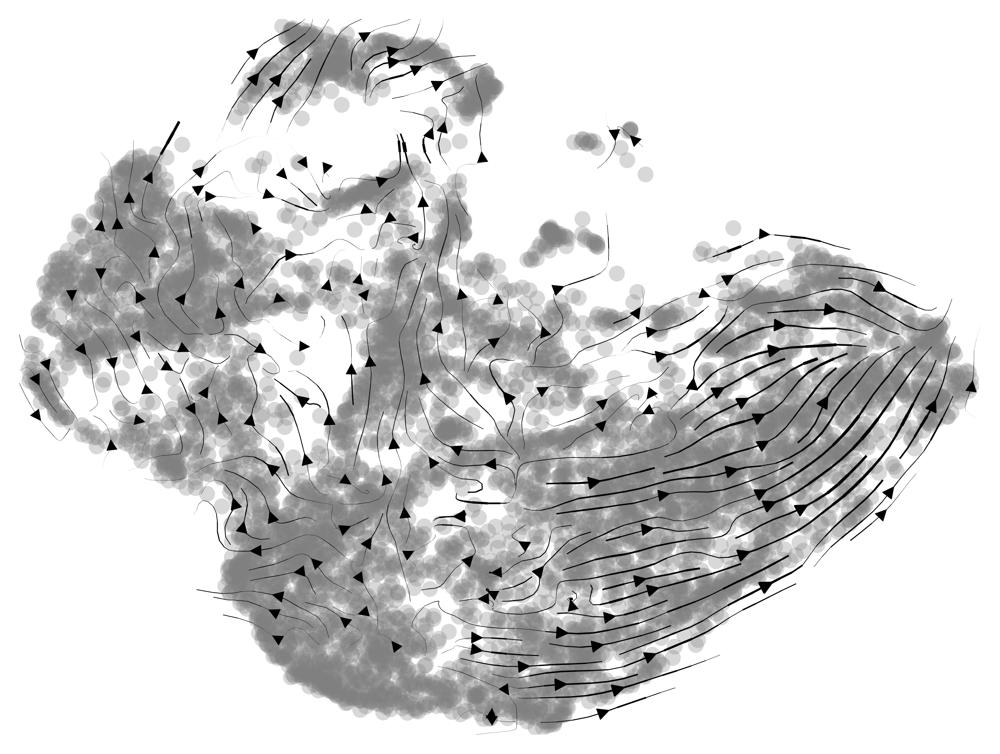

In [21]:
scv.pl.velocity_embedding_stream(sample_one, basis='X_umap', dpi=300,
                                 save="JE_combined_epi_dynamic_velo_gray.svg") # change name accordingly

saving figure to file ./figures/scvelo_JE_combined_epi_dynamic_velo_color.svg


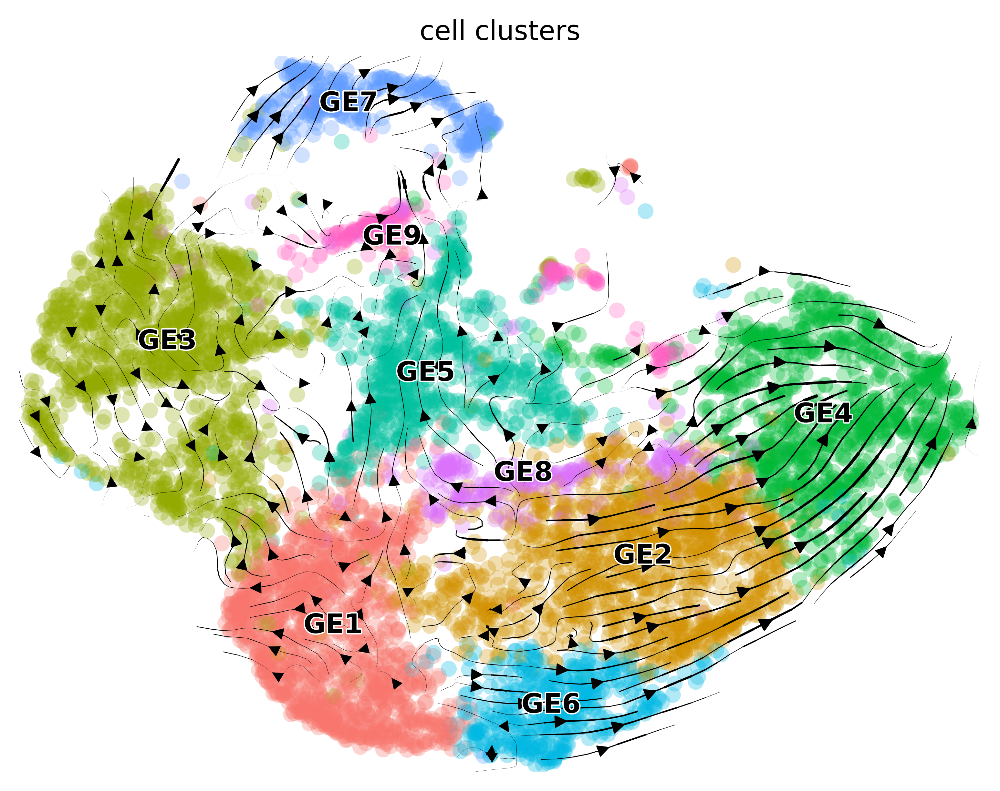

In [22]:
scv.pl.velocity_embedding_stream(sample_one, basis='X_umap',color = "cell_clusters",
                                 palette = ident_colors, dpi=300,
                                 save="JE_combined_epi_dynamic_velo_color.svg")# change name accordingly

saving figure to file ./figures/scvelo_JE_combined_epi_dynamic_velo_emb_color.svg


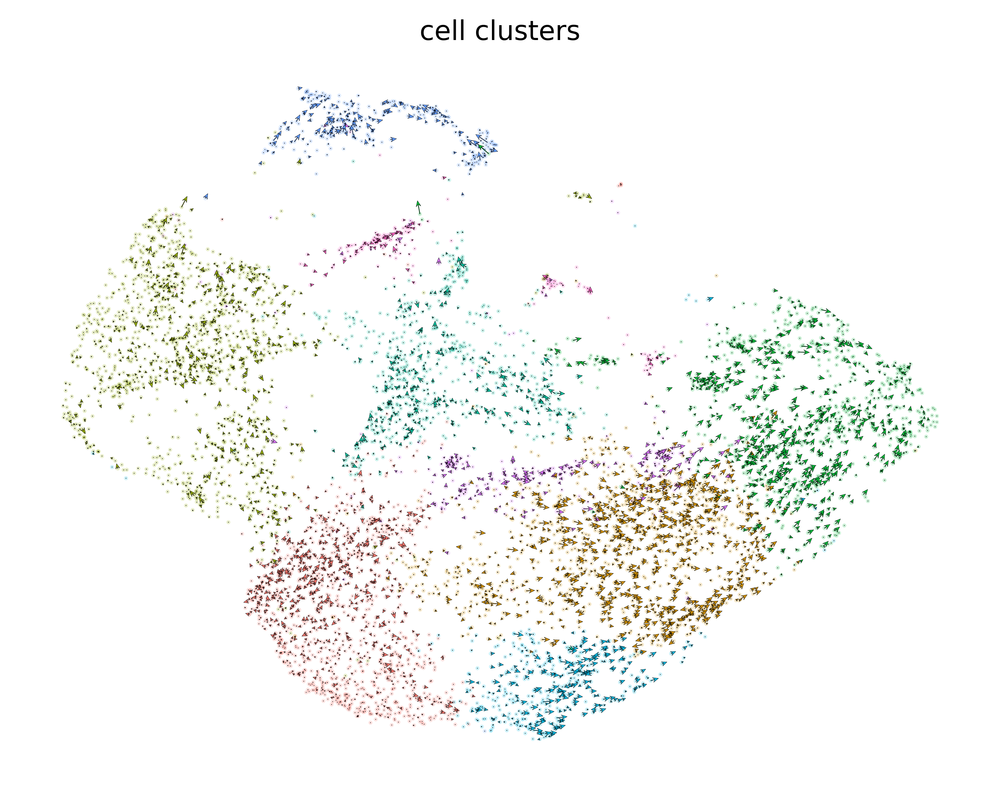

In [23]:
scv.pl.velocity_embedding(sample_one, basis='X_umap',
                          color = "cell_clusters",palette = ident_colors, dpi=300,
                          save="JE_combined_epi_dynamic_velo_emb_color.svg")# change name accordingly

In [27]:
sample_one.write(r'JE_combined_epi_dynamic.h5ad', compression='gzip') # for next time reload

sample_one = scv.read(r'JE_combined_epi_dynamic.h5ad') #example script for reloading script

In [28]:
scv.tl.velocity(sample_one, mode='dynamical', vkey='dynamical_velocity', n_jobs = 8)
scv.tl.velocity_graph(sample_one, vkey='dynamical_velocity', variance_stabilization=True, n_jobs = 8)

computing velocities
    finished (0:02:22) --> added 
    'dynamical_velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/24 cores)
    finished (0:01:31) --> added 
    'dynamical_velocity_graph', sparse matrix with cosine correlations (adata.uns)


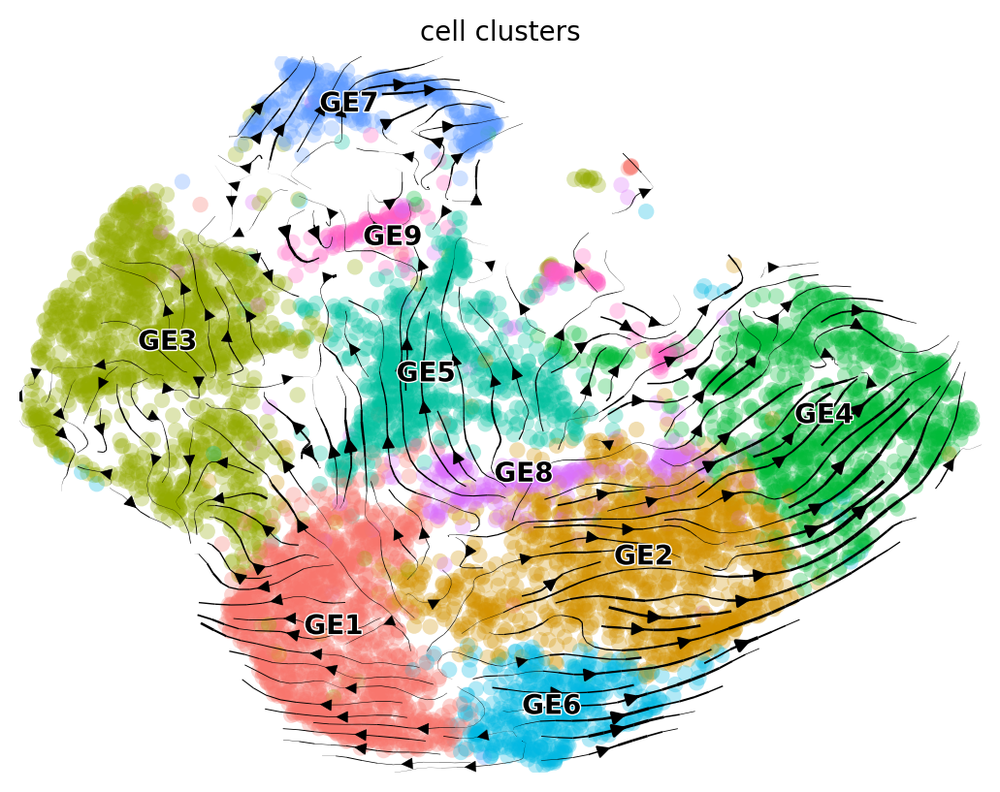

In [34]:
scv.pl.velocity_embedding_stream(sample_one, color = "cell_clusters",
                                 palette = ident_colors,
                                 vkey='dynamical_velocity')

saving figure to file ./figures/scvelo_JE_combined_epi_dynamic_velo_emb_color_arrow.svg


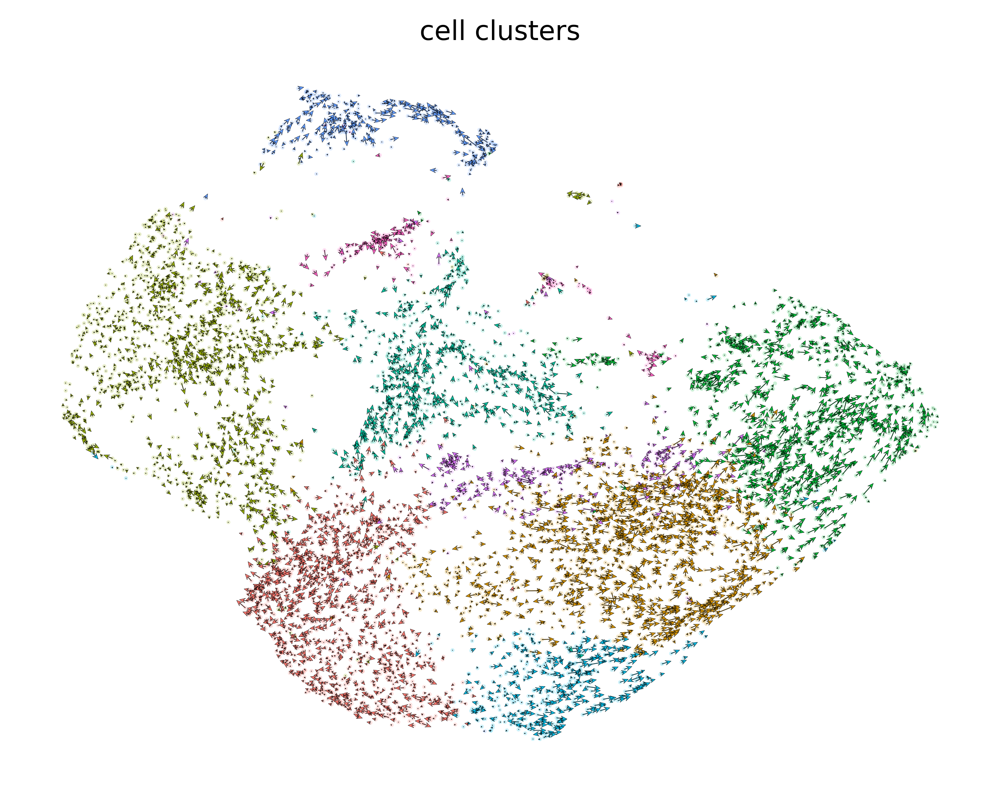

In [39]:
scv.pl.velocity_embedding(sample_one, vkey='dynamical_velocity', scale=.5, 
                          color = "cell_clusters",
                          palette = ident_colors, dpi=300,
                          save="JE_combined_epi_dynamic_velo_emb_color_arrow.svg")

In [32]:
sample_one #check the resulted data structure

AnnData object with n_obs × n_vars = 6883 × 28000
    obs: 'cell_clusters', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'dynamical_velocity_self_transition'
    var: 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'gene_count_corr', 'fit_r2', 'velocity_genes', 'dynamical_velocity_genes'
    uns: 'cell_clusters_colors', 'neighbors', 'pca', 'recover_dynamics', 'velocity_graph', 'velocity_graph_neg', 'velocity_params', 'dynamical_velocity_params', 'dynamical_velocity_graph', 'dynamical_velocity_graph_neg'
    obsm: 'X_pca', 'X_umap', 'velocity_umap', 'dynamical_velocity_umap'
    varm: 'PCs', 'loss'
    layers: 'Ms', 'Mu', 'fit_t', 'fit_tau', 'fit_tau_', 'spliced', 'unspliced', 'velocity', 'velocity_u', 'dynamical_velocity', 'dynamical_velocity_u'
    obsp: 'c

In [33]:
sample_one.write(r'JE_combined_epi_dynamic.h5ad', compression='gzip') # for next time reload

sample_one = scv.read(r'JE_combined_epi_dynamic.h5ad') #example script for reloading script

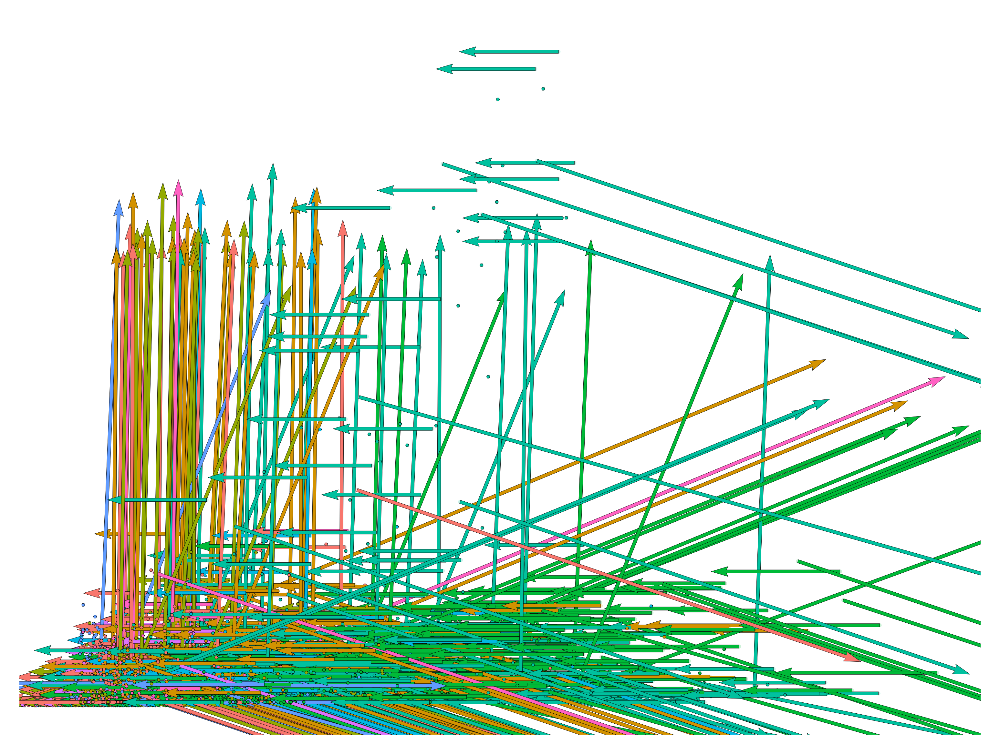

In [40]:
scv.pl.velocity_embedding(sample_one, vkey='dynamical_velocity', basis='Klf4', 
                          color = "cell_clusters",
                          palette = ident_colors, dpi=300,
                          scale=10, #the larger the number, the longer arrows you will see
                          width=.0035,
                         frameon=False, title='')



## 3.2 Kinetic parameters



The rates of RNA transcription, splicing and degradation are estimated without the need of any experimental data.

They can be useful to better understand the cell identity and phenotypic heterogeneity.


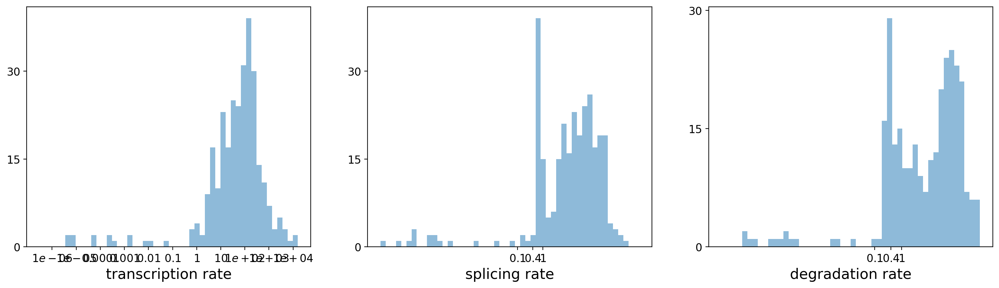

,fit_alpha,fit_beta,fit_gamma,fit_t_,fit_scaling,fit_std_u,fit_std_s,fit_likelihood,fit_u0,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling,fit_r2
Xkr4,13.592880,7.845818,10.297643,1.509322e+00,0.472500,1.000000,1.000000,3.554813e-01,0.0,0.0,1.000000,0.000000,0.000000,0.170437,0.121387,-0.561895
Mrpl15,0.000010,0.000008,0.000002,1.199245e+06,0.128808,0.275517,1.010669,2.996925e-07,0.0,0.0,0.474749,2.000000,3.275862,1.786267,472257.837096,-0.035774
Rgs20,2.582454,0.343132,0.167382,2.162330e+00,2.871235,3.054024,0.886385,4.179333e-02,0.0,0.0,0.497488,27.000001,3.275862,11.797049,0.910338,0.424673
4732440D04Rik,32.796169,32.796169,32.796202,5.608020e-01,1.650000,1.000000,1.000000,3.989423e-01,0.0,0.0,1.000000,0.000000,0.000000,0.000000,0.030491,-0.037813
Gm26901,20.685166,20.685166,20.685186,8.891472e-01,1.650000,1.000000,1.000000,3.989423e-01,0.0,0.0,1.000000,0.000000,0.000000,0.000000,0.048344,-0.333965


In [41]:
df = sample_one.var
df = df[(df['fit_likelihood'] > .1) & df['velocity_genes'] == True]

kwargs = dict(xscale='log', fontsize=16)
with scv.GridSpec(ncols=3) as pl:
    pl.hist(df['fit_alpha'], xlabel='transcription rate', **kwargs)
    pl.hist(df['fit_beta'] * df['fit_scaling'], xlabel='splicing rate', xticks=[.1, .4, 1], **kwargs)
    pl.hist(df['fit_gamma'], xlabel='degradation rate', xticks=[.1, .4, 1], **kwargs)

scv.get_df(sample_one, 'fit*', dropna=True).head()

## 3.3 Root cell 

The root cells and end points will be then used for selection step in monocle3.
Here I refered to the thread: https://github.com/theislab/scvelo/issues/223

In [42]:
scv.tl.velocity_graph(sample_one, mode_neighbors='connectivities', n_jobs=8)

computing velocity graph (using 8/24 cores)
    finished (0:00:47) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [43]:
scv.tl.terminal_states(sample_one)

computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


In [44]:
scv.tl.latent_time(sample_one)

computing latent time using root_cells as prior
    finished (0:01:31) --> added 
    'latent_time', shared time (adata.obs)


/home/liuhuan/.local/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()


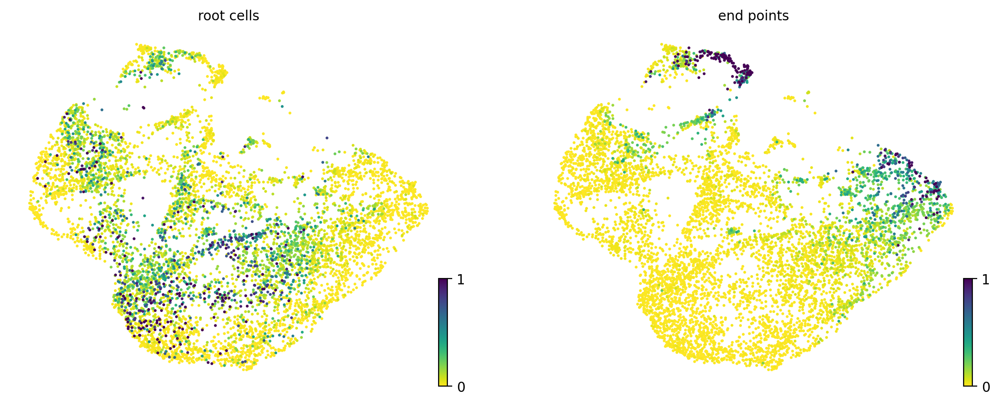

In [45]:
scv.pl.scatter(sample_one, color=[ 'root_cells', 'end_points'])

In [46]:
sample_one.write(r'JE_combined_epi_dynamic.h5ad', compression='gzip') # for next time reload


## 3.4 PAGA

In [47]:
# PAGA requires to install igraph, if not done yet.
!pip install python-igraph --upgrade --quiet



In [48]:
sample_one.uns['neighbors']['distances'] = sample_one.obsp['distances']
sample_one.uns['neighbors']['connectivities'] = sample_one.obsp['connectivities']


In [49]:
scv.tl.paga(sample_one, groups='cell_clusters')

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:03) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


In [50]:
df = scv.get_df(sample_one, 'paga/transitions_confidence', precision=2).T
df.style.background_gradient(cmap='Blues').format('{:.2g}')

,GE1,GE2,GE3,GE4,GE5,GE6,GE7,GE8,GE9
GE1,0,0,0.012,0,0,0,0,0,0
GE2,0,0,0,0.027,0,0,0,0,0
GE3,0,0,0,0,0,0,0.025,0,0
GE4,0,0,0,0,0,0,0,0,0
GE5,0,0,0,0,0,0,0,0,0
GE6,0,0,0,0,0,0,0,0,0
GE7,0,0,0,0,0,0,0,0,0
GE8,0,0.018,0,0,0,0,0,0,0
GE9,0,0,0,0,0,0,0.016,0,0


This reads from left/row to right/column, thus e.g. assigning a confident transition from GE2 to GE4, GE3 to GE7, GE9 to GE7.

This table can be summarized by a directed graph superimposed onto the UMAP embedding.

/home/liuhuan/.local/lib/python3.8/site-packages/networkx/convert.py:158: DeprecationWarning: 

The scipy.sparse array containers will be used instead of matrices
in Networkx 3.0. Use `from_scipy_sparse_array` instead.
  return nx.from_scipy_sparse_matrix(data, create_using=create_using)


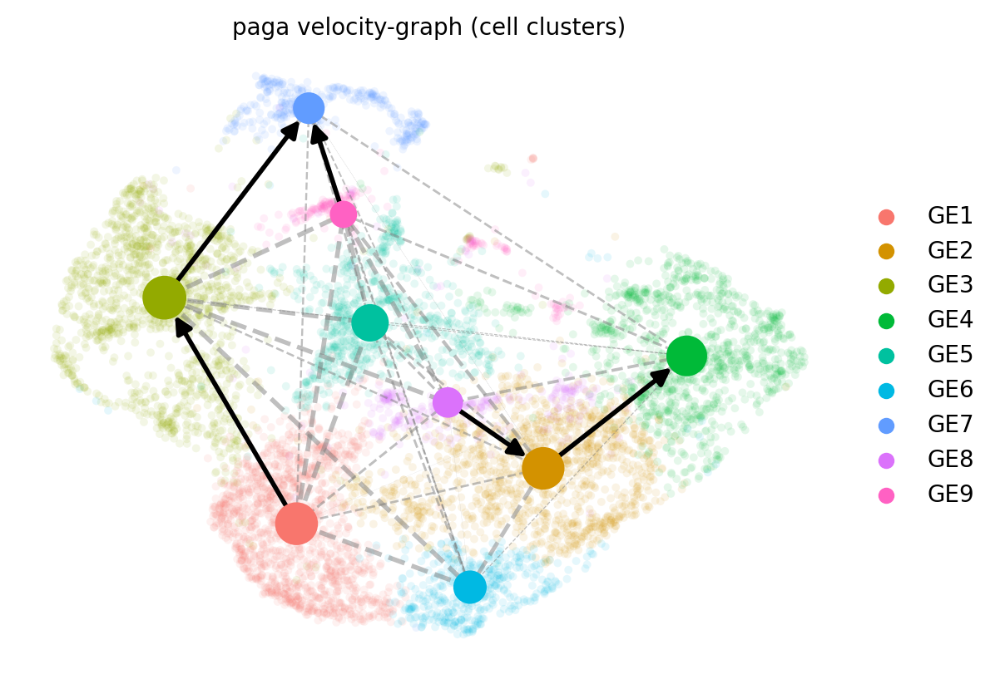

In [51]:
scv.pl.paga(sample_one, basis='umap', size=50, alpha=.1,
            min_edge_width=2, node_size_scale=1.5)



From the above plot, we can get two relatively paths: GE1-> GE3->GE7 and GE8->GE2->GE4.
    

In [52]:
sample_one.write(r'JE_combined_epi_dynamic_paga.h5ad', compression='gzip') # for next time reload

sample_one = scv.read(r'JE_combined_epi_dynamic.h5ad') #example script for reloading script

## 3.5 Top-likelihood genes

Driver genes display pronounced dynamic behavior and are systematically detected via their characterization by high likelihoods in the dynamic model.

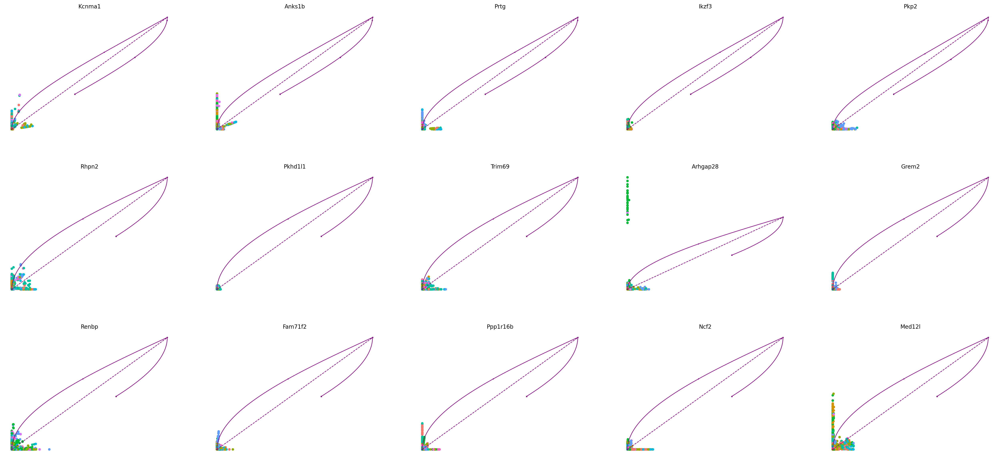

In [53]:
top_genes = sample_one.var['fit_likelihood'].sort_values(ascending=False).index
scv.pl.scatter(sample_one, basis=top_genes[:15], 
               color = "cell_clusters",
               palette = ident_colors, size=80,
               ncols=5, frameon=False)

## 3.6 Cluster specific top-likelihood genes

We need a systematic way to identify genes that may help explain the resulting vector field and inferred lineages. To do so, we can test which genes have cluster-specific differential velocity expression, being siginificantly higher/lower compared to the remaining population. The module scv.tl.rank_velocity_genes runs a differential velocity t-test and outpus a gene ranking for each cluster. Thresholds can be set (e.g. min_corr) to restrict the test on a selection of gene candidates.


In [54]:
scv.tl.rank_dynamical_genes(sample_one, groupby='cell_clusters')
df = scv.get_df(sample_one, 'rank_dynamical_genes/names')
df.head(5)



ranking genes by cluster-specific likelihoods
    finished (0:02:36) --> added 
    'rank_dynamical_genes', sorted scores by group ids (adata.uns)


,GE1,GE2,GE3,GE4,GE5,GE6,GE7,GE8,GE9
0,Pappa,Krt24,Anln,Me1,Pfdn4,Krt24,Cdo1,Rplp2,Htra1
1,Rps29,Gstm5,Arl6ip1,Krt24,Hk2,Lgi2,Odam,Mt4,S100a11
2,Eif3k,Tesc,Hmmr,Aox4,Fam72a,Cops5,Fam20a,Rps3,Crip1
3,Hbb-bs,Rpl26,Kif23,Ace2,Samd4,Capg,Rab10,Rps5,Prdx2
4,Ndufc2,Cops6,Kif11,Hopx,Egfl6,Rpl32,Hif1a,Uqcrh,Rps19


In [55]:
sample_one.write(r'JE_combined_epi_dynamic.h5ad', compression='gzip') # for next time reload

In [56]:
df.to_csv (r'JE_combined_epi_dynamic_genes.csv', 
           index = True, header=True) # export the most dynamical genes into csv files

In [57]:
scv.tl.recover_dynamics(sample_one, var_names=['Odam', 'Pappa', 'Krt24', 'Htra1'], max_iter=100)
scv.tl.velocity(sample_one, vkey='dynamical_velocity', mode='dynamical')


recovering dynamics (using 1/24 cores)
    finished (0:00:26) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)

outputs model fit of gene: Htra1
computing velocities
    finished (0:03:06) --> added 
    'dynamical_velocity', velocity vectors for each individual cell (adata.layers)


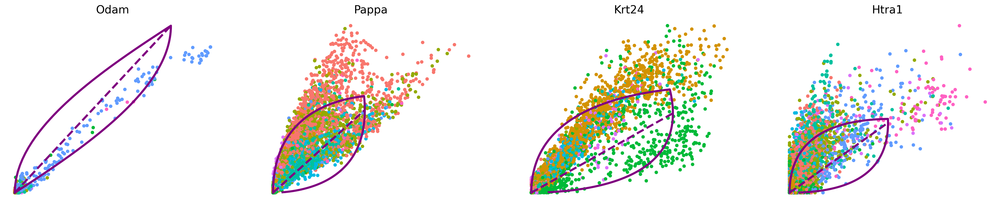

In [61]:
scv.pl.scatter(sample_one, basis=['Odam', 'Pappa', 'Krt24', 'Htra1'], fontsize=16, size=100, linewidth=3,
               color = "cell_clusters",
               palette = ident_colors, 
               frameon=False, legend_loc='none')

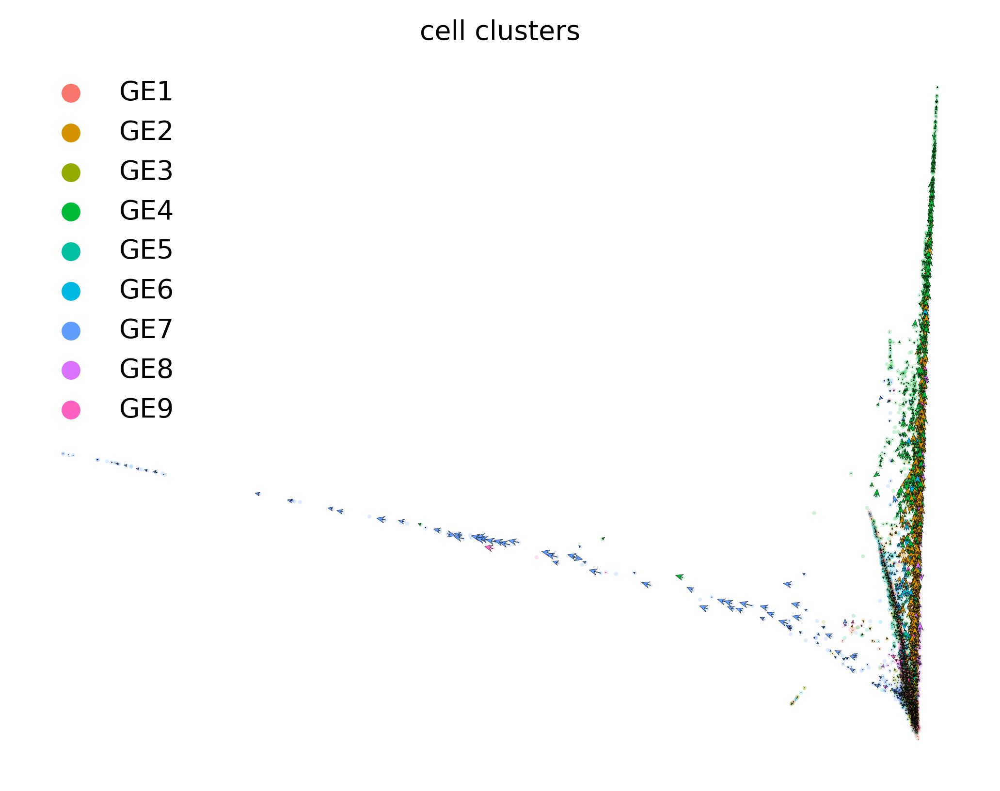

In [66]:
scv.pl.velocity_embedding(sample_one, basis='diffmap', vkey='dynamical_velocity', components='2,3',
                          color = "cell_clusters",
               palette = ident_colors, 
                          arrow_length=3, arrow_size=1.4,
                          legend_loc='best', 
                          scale=.5, density=.8, dpi=200)

